## Before EDA

In [39]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors


pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [3]:
data = pd.read_csv("data_processed.csv")
data.head(5)

,Year,quarter,brentcrude,route_id,city1,city2,nsmiles,passengers,passenger_proportion_change,fare,fare_proportion_change,carrier_lm,ms_lm,fare_lm,carrier_lf,ms_lf,fare_lf
0,1997,1,21.361892,30135_30194,"Allentown/Bethlehem/Easton, PA","Dallas/Fort Worth, TX",1308,34,-0.150000,326.12,0.216185,US,0.41,344.92,DL,0.24,307.54
1,1998,1,14.445485,30135_30194,"Allentown/Bethlehem/Easton, PA","Dallas/Fort Worth, TX",1308,40,0.176471,318.51,-0.023335,US,0.43,316.90,US,0.43,316.90
2,1999,1,11.500461,30135_30194,"Allentown/Bethlehem/Easton, PA","Dallas/Fort Worth, TX",1308,39,-0.025000,312.45,-0.019026,US,0.41,302.36,US,0.41,302.36
3,2000,1,27.052719,30135_30194,"Allentown/Bethlehem/Easton, PA","Dallas/Fort Worth, TX",1308,38,-0.025641,343.93,0.100752,US,0.39,298.41,US,0.39,298.41
4,2001,1,26.240348,30135_30194,"Allentown/Bethlehem/Easton, PA","Dallas/Fort Worth, TX",1308,43,0.131579,349.89,0.017329,US,0.41,337.44,US,0.41,337.44


In [9]:
data.describe()

,Year,quarter,brentcrude,nsmiles,passengers,passenger_proportion_change,fare,fare_proportion_change,ms_lm,fare_lm,ms_lf,fare_lf
count,582513.000000,582513.000000,582513.000000,582513.000000,582513.000000,582513.000000,582513.000000,582513.000000,582513.000000,582513.000000,582513.000000,582513.000000
mean,2010.383600,2.509364,62.320256,1047.995274,186.324209,0.081685,238.088597,0.031286,0.595741,238.536599,0.388697,209.168563
std,7.813836,1.113707,30.838757,586.371315,645.180320,0.527612,72.830463,0.168127,0.198987,77.967902,0.274948,70.396570
min,1997.000000,1.000000,11.499423,62.000000,10.000000,-0.984927,51.500000,-0.770663,0.100000,50.510000,0.010000,50.000000
25%,2004.000000,2.000000,31.733722,594.000000,17.000000,-0.110721,186.070000,-0.065455,0.440000,183.600000,0.164400,158.130000
50%,2011.000000,3.000000,61.612504,922.000000,35.000000,0.004854,234.310000,0.022085,0.562900,234.660000,0.310000,204.360000
75%,2017.000000,4.000000,82.323613,1406.000000,105.000000,0.166667,284.620000,0.113935,0.733300,287.300000,0.560100,254.390000
max,2024.000000,4.000000,122.218644,2783.000000,25471.000000,37.545455,770.650000,3.715368,1.000000,802.640000,1.000000,761.050000


In [4]:
# Examine the data type and missing values
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 582513 entries, 0 to 582512
Data columns (total 17 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   Year                         582513 non-null  int64  
 1   quarter                      582513 non-null  int64  
 2   brentcrude                   582513 non-null  float64
 3   route_id                     582513 non-null  object 
 4   city1                        582513 non-null  object 
 5   city2                        582513 non-null  object 
 6   nsmiles                      582513 non-null  int64  
 7   passengers                   582513 non-null  int64  
 8   passenger_proportion_change  582513 non-null  float64
 9   fare                         582513 non-null  float64
 10  fare_proportion_change       582513 non-null  float64
 11  carrier_lm                   582513 non-null  object 
 12  ms_lm                        582513 non-null  float64
 13 

## EDA

### Group by 'route' to calculate both the total passengers and the count of occurrences

In [10]:
route_summary = data.groupby('route_id').agg(
    total_passengers=('passengers', 'sum'),
    route_count=('route_id', 'count'),
    average_passengers=('passengers', 'mean'),
    unique_year_count=('Year', 'nunique')  
).reset_index()

# Sort the results by total passengers in descending order
route_summary = route_summary.sort_values(by='route_count', ascending=False)

# Display the resulting DataFrame
route_summary.head(10)

,route_id,total_passengers,route_count,average_passengers,unique_year_count
3514,30994_30977,32745,109,300.412844,28
6736,32575_33316,51960,109,476.697248,28
1373,30423_30559,51092,109,468.733945,28
1372,30423_30529,10569,109,96.963303,28
4674,31453_34057,35533,109,325.990826,28
6740,32575_33367,6289,109,57.697248,28
1369,30423_30466,63382,109,581.486239,28
1368,30423_30436,6254,109,57.376147,28
2642,30721_31057,123898,109,1136.678899,28
6745,32575_33485,16255,109,149.128440,28


In [8]:
### Routes with average passengers above total average (187 passengers)

# routes_with_more_than_187_passengers = route_summary[route_summary['average_passengers'] > 187]
# count_routes_with_more_than_187_passengers = len(routes_with_more_than_187_passengers)
# print(count_routes_with_more_than_187_passengers)
# routes_with_more_than_187_passengers.head()

In [10]:
# route_summary['route_count_bins'] = pd.cut(route_summary['route_count'], bins=4, labels=['Low', 'Medium', 'High', 'Very High'])

# # Step 2: Count the number of routes in each bin (optional, for visualization)
# route_count_summary = route_summary['route_count_bins'].value_counts().sort_index()

# # Step 3: Visualize the binned data using a bar plot
# plt.figure(figsize=(8, 6))
# sns.barplot(x=route_count_summary.index, y=route_count_summary.values)
# plt.xlabel('Route Count Bins')
# plt.ylabel('Number of Routes')
# plt.title('Number of Routes by Route Count Bins')
# plt.tight_layout()
# plt.show()

### Analyze the Frequency of Carriers with Highest Market Share 

In [40]:
freq_carrier_lg = pd.crosstab(index = data['carrier_lm'], columns = 'counts')
freq_carrier_lg = freq_carrier_lg.sort_values(by='counts', ascending=False)

freq_carrier_lg.head(20)

col_0,counts
carrier_lm,
DL,173897
AA,112713
UA,69595
WN,63832
US,55155
NW,38864
CO,15116
G4,13802
AS,13231


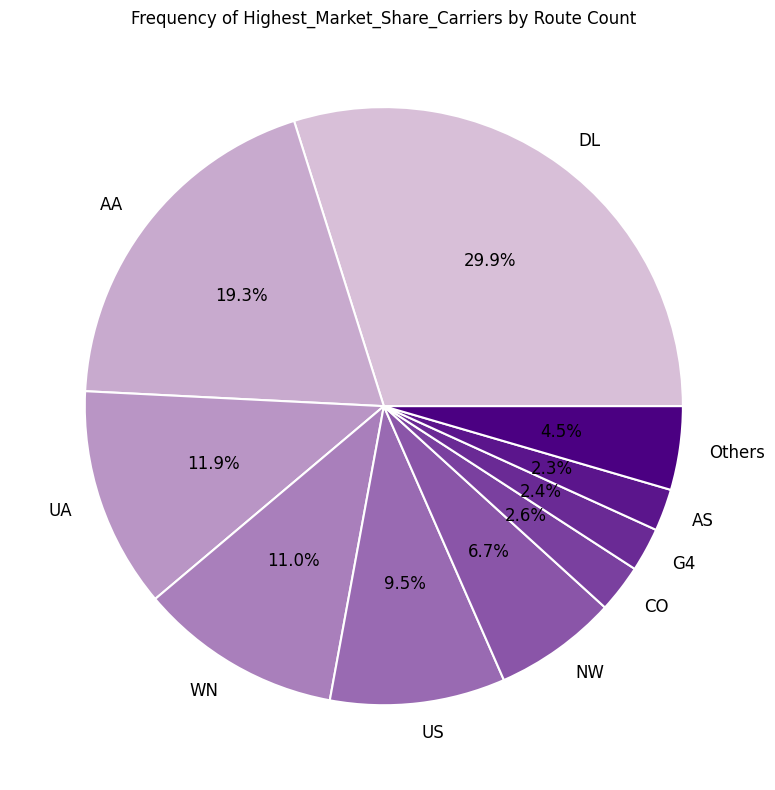

In [54]:
freq_carrier_lg_sorted = freq_carrier_lg.sort_values(by='counts', ascending=False)

top_20_percent_count = int(len(freq_carrier_lg_sorted) * 0.2)

# Slice the DataFrame to include only the top 20% entries
top_20_percent_data = freq_carrier_lg_sorted.head(top_20_percent_count)

others_count = freq_carrier_lg_sorted['counts'].iloc[top_20_percent_count:].sum()

# Add the "Others" row to the top 20% data
top_20_percent_data_with_others = top_20_percent_data.copy()
top_20_percent_data_with_others.loc['Others'] = others_count

base_color = '#D8BFD8'  # Light purple color
darker_color = '#4B0082'  # A darker shade of purple

cmap = mcolors.LinearSegmentedColormap.from_list('gradient', [base_color, darker_color], N=len(top_20_percent_data_with_others))

colors = [cmap(i / len(top_20_percent_data_with_others)) for i in range(len(top_20_percent_data_with_others))]

# Create the pie chart with the combined data and the custom color palette
top_20_percent_data_with_others['counts'].plot(
    kind='pie',
    autopct='%1.1f%%',
    labels=top_20_percent_data_with_others.index,
    figsize=(8, 8),
    colors=colors, 
    wedgeprops={'edgecolor': 'white', 'linewidth': 1.5}, 
    textprops={'fontsize': 12}
)

plt.title('Frequency of Highest_Market_Share_Carriers by Route Count')

plt.ylabel('')
plt.tight_layout()
plt.show()

            

### Analyze the Frequency of Carriers with Lowest Fares 

In [35]:
freq_carrier_low = pd.crosstab(index = data['carrier_lf'], columns = 'counts')
freq_carrier_low = freq_carrier_low.sort_values(by='counts', ascending=False)

freq_carrier_low.head(20)

col_0,counts
carrier_lf,
AA,106662
WN,92111
DL,91581
UA,84856
US,49005
NW,40990
CO,22020
G4,16708
F9,15207


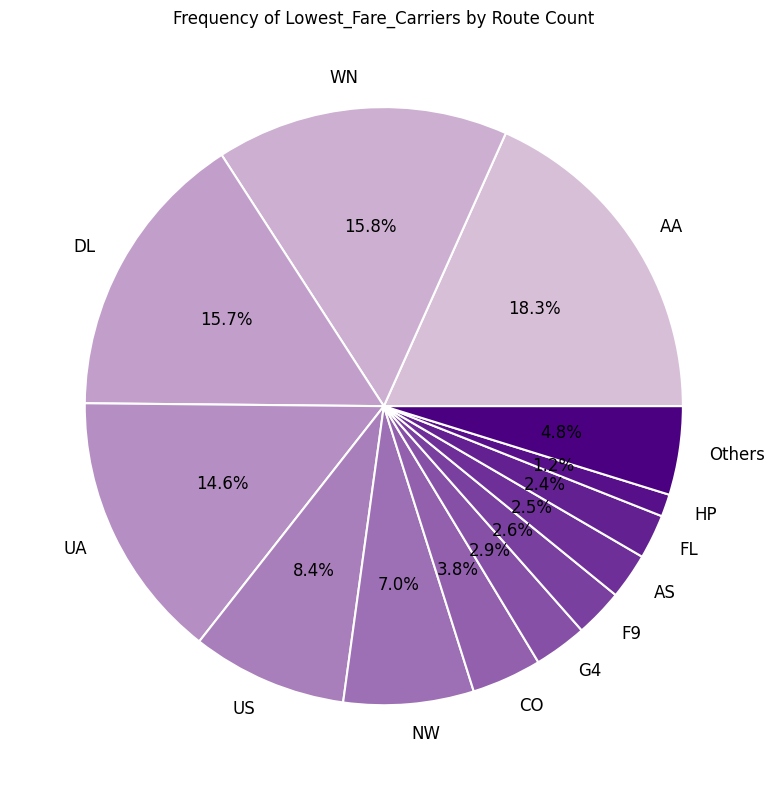

In [53]:
freq_carrier_low_sorted = freq_carrier_low.sort_values(by='counts', ascending=False)

top_20_percent_count = int(len(freq_carrier_low_sorted) * 0.2)

# Slice the DataFrame to include only the top 20% entries
top_20_percent_data = freq_carrier_low_sorted.head(top_20_percent_count)

others_count = freq_carrier_low_sorted['counts'].iloc[top_20_percent_count:].sum()

# Add the "Others" row to the top 20% data
top_20_percent_data_with_others = top_20_percent_data.copy()
top_20_percent_data_with_others.loc['Others'] = others_count

base_color = '#D8BFD8'  # Light purple color
darker_color = '#4B0082'  # A darker shade of purple

cmap = mcolors.LinearSegmentedColormap.from_list('gradient', [base_color, darker_color], N=len(top_20_percent_data_with_others))

colors = [cmap(i / len(top_20_percent_data_with_others)) for i in range(len(top_20_percent_data_with_others))]

# Create the pie chart with the combined data and the custom color palette
top_20_percent_data_with_others['counts'].plot(
    kind='pie',
    autopct='%1.1f%%',
    labels=top_20_percent_data_with_others.index,
    figsize=(8, 8),
    colors=colors, 
    wedgeprops={'edgecolor': 'white', 'linewidth': 1.5}, 
    textprops={'fontsize': 12}
)


plt.title('Frequency of Lowest_Fare_Carriers by Route Count')
plt.ylabel('')
plt.tight_layout()
plt.show()

### Binning "nsmiles"

In [23]:
bins = [0, 1000, 2000, float('inf')]
labels = ['Short-Haul (under 1000 miles)', 'Medium-Haul (1000 to 2000 miles)', 'Long-Haul (more than 2000 miles)']

# Create a new column 'haul_category' with the binned values
data['haul_category'] = pd.cut(data['nsmiles'], bins=bins, labels=labels)

# Display the resulting DataFrame with the new 'haul_category' column
print(data[['nsmiles', 'haul_category']])


        nsmiles                     haul_category
0          1308  Medium-Haul (1000 to 2000 miles)
1          1308  Medium-Haul (1000 to 2000 miles)
2          1308  Medium-Haul (1000 to 2000 miles)
3          1308  Medium-Haul (1000 to 2000 miles)
4          1308  Medium-Haul (1000 to 2000 miles)
5          1308  Medium-Haul (1000 to 2000 miles)
6          1308  Medium-Haul (1000 to 2000 miles)
7          1308  Medium-Haul (1000 to 2000 miles)
8          1308  Medium-Haul (1000 to 2000 miles)
9          1308  Medium-Haul (1000 to 2000 miles)
10         1308  Medium-Haul (1000 to 2000 miles)
11         1308  Medium-Haul (1000 to 2000 miles)
12         1308  Medium-Haul (1000 to 2000 miles)
13         1308  Medium-Haul (1000 to 2000 miles)
14         1308  Medium-Haul (1000 to 2000 miles)
15         1307  Medium-Haul (1000 to 2000 miles)
16         1307  Medium-Haul (1000 to 2000 miles)
17         1307  Medium-Haul (1000 to 2000 miles)
18         1307  Medium-Haul (1000 to 2000 miles)


/var/folders/xl/pn75d9653_b3gyymyqzpdyc00000gn/T/ipykernel_14107/3625732149.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  fare_summary = data.groupby('haul_category')['fare'].mean().reset_index()


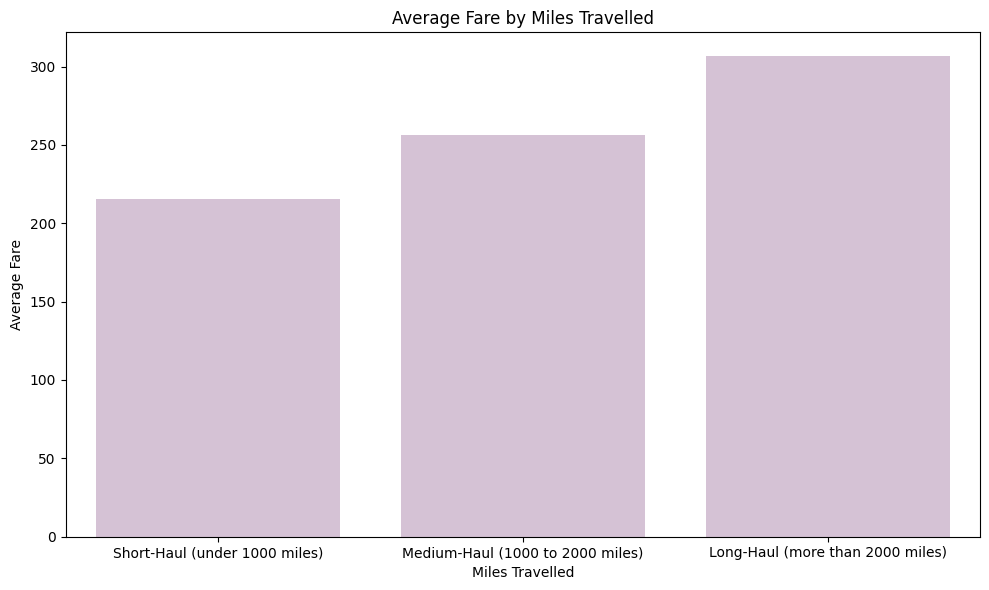

In [26]:
fare_summary = data.groupby('haul_category')['fare'].mean().reset_index()

plt.figure(figsize=(10, 6))
sns.barplot(x='haul_category', y='fare', data=fare_summary, color='#D8BFD8')
plt.xlabel('Miles Travelled')
plt.ylabel('Average Fare')
plt.title('Average Fare by Miles Travelled')
plt.tight_layout()
plt.show()

/var/folders/xl/pn75d9653_b3gyymyqzpdyc00000gn/T/ipykernel_14107/1298456412.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  fare_summary = data.groupby('haul_category')['passengers'].sum().reset_index()


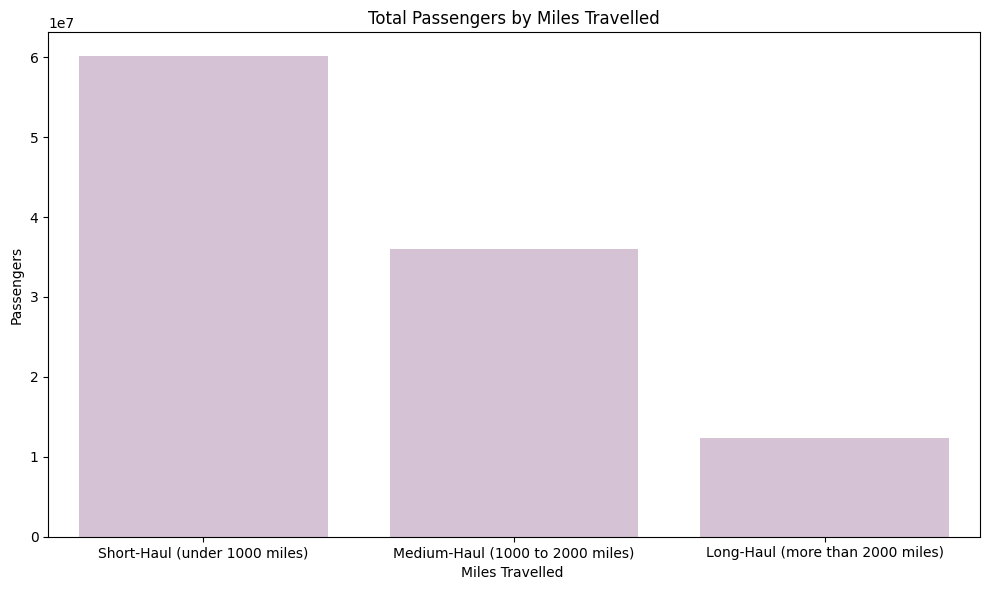

In [33]:
fare_summary = data.groupby('haul_category')['passengers'].sum().reset_index()

plt.figure(figsize=(10, 6))
sns.barplot(x='haul_category', y='passengers', data=fare_summary, color='#D8BFD8')
plt.xlabel('Miles Travelled ')
plt.ylabel('Passengers')
plt.title('Total Passengers by Miles Travelled')
plt.tight_layout()
plt.show()

### Line chart for Brent Crude Trend

<Axes: xlabel='brentcrude', ylabel='fare'>

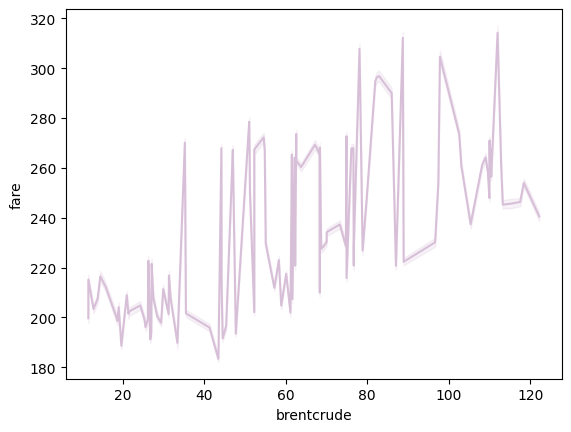

In [21]:
sns.lineplot(data=data, x='brentcrude', y='fare', color='#D8BFD8')



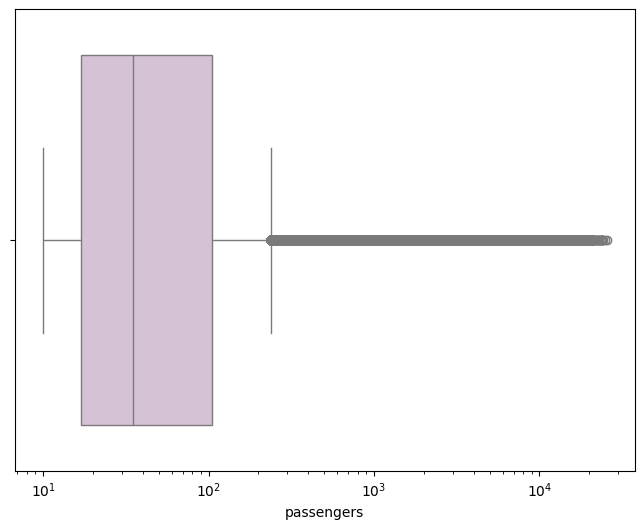

In [20]:
plt.figure(figsize=(8, 6))
sns.boxplot(x=data['passengers'], color='#D8BFD8')
plt.xscale('log') 

### Examine the target variable

<Axes: xlabel='fare', ylabel='Count'>

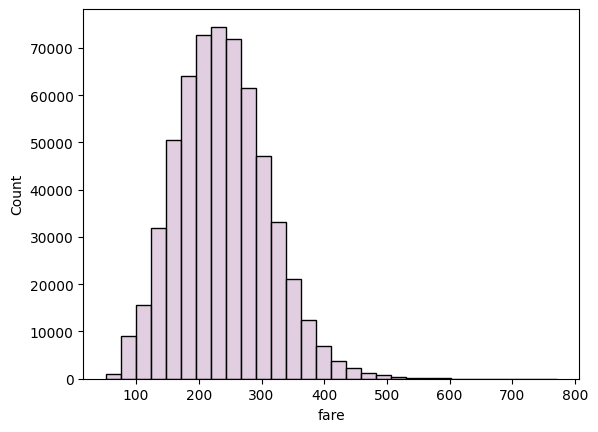

In [11]:
sns.histplot(x = data['fare'], bins=30, color='#D8BFD8')